In [35]:
import numpy as np
import pandas as pd
import os, math, sys
import glob, itertools
import argparse, random

import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.autograd import Variable
from torchvision.models import vgg19
import torchvision.transforms as transforms
from torch.utils.data import DataLoader, Dataset
from torchvision.utils import save_image, make_grid
from torchvision.transforms import ToTensor

import plotly
import plotly.express as px
import plotly.graph_objects as go
import matplotlib.pyplot as plt

from PIL import Image
from tqdm import tqdm
from sklearn.model_selection import train_test_split

random.seed(42)
import warnings
warnings.filterwarnings("ignore")
from torchsummary import summary

In [36]:
load_pretrained_models=True
dataset_path = "./datasets/"
batch_size=1
lr=0.0001
b1=0.5
b2=0.999
hr_height=256
hr_width=256
channels=3
os.makedirs("images", exist_ok=True)
cuda = torch.cuda.is_available()
hr_shape = (hr_height, hr_width)

In [37]:
class FeatureExtractor(nn.Module):
    def __init__(self):
        super(FeatureExtractor, self).__init__()
        vgg19_model = vgg19(pretrained=True)
        self.feature_extractor = nn.Sequential(*list(vgg19_model.features.children())[:18])
    def forward(self, img):
        return self.feature_extractor(img)

class ResidualBlock(nn.Module):
    def __init__(self, in_features):
        super(ResidualBlock, self).__init__()
        self.conv_block = nn.Sequential(
            nn.Conv2d(in_features, in_features, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(in_features, 0.8),
            nn.PReLU(),
            nn.Conv2d(in_features, in_features, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(in_features, 0.8),
        )

    def forward(self, x):
        return x + self.conv_block(x)

In [38]:
class GeneratorResNet(nn.Module):
    def __init__(self, in_channels=3, out_channels=3, n_residual_blocks=16):
        super(GeneratorResNet, self).__init__()
        self.conv1=nn.Sequential(nn.Conv2d(in_channels, 64, kernel_size=9, stride=1, padding=4), nn.PReLU())
        res_blocks=[]
        for _ in range(n_residual_blocks):
            res_blocks.append(ResidualBlock(64))
        self.res_blocks = nn.Sequential(*res_blocks)
        self.conv2=nn.Sequential(nn.Conv2d(64, 64, kernel_size=3, stride=1, padding=1), nn.BatchNorm2d(64, 0.8))
        upsampling=[]
        for out_features in range(2):
            upsampling += [
                nn.Conv2d(64, 256, 3, 1, 1),
                nn.BatchNorm2d(256),
                nn.PixelShuffle(upscale_factor=2),
                nn.PReLU(),
            ]
        self.upsampling = nn.Sequential(*upsampling)
        self.conv3 = nn.Sequential(nn.Conv2d(64, out_channels, kernel_size=9, stride=1, padding=4), nn.Tanh())

    def forward(self, x):
        out1=self.conv1(x)
        out=self.res_blocks(out1)
        out2=self.conv2(out)
        out=torch.add(out1, out2)
        out=self.upsampling(out)
        out=self.conv3(out)
        return out

In [39]:
class Discriminator(nn.Module):
    def __init__(self, input_shape):
        super(Discriminator, self).__init__()

        self.input_shape = input_shape
        in_channels, in_height, in_width = self.input_shape
        patch_h, patch_w = int(in_height / 2 ** 4), int(in_width / 2 ** 4)
        self.output_shape = (1, patch_h, patch_w)

        def discriminator_block(in_filters, out_filters, first_block=False):
            layers = []
            layers.append(nn.Conv2d(in_filters, out_filters, kernel_size=3, stride=1, padding=1))
            if not first_block:
                layers.append(nn.BatchNorm2d(out_filters))
            layers.append(nn.LeakyReLU(0.2, inplace=True))
            layers.append(nn.Conv2d(out_filters, out_filters, kernel_size=3, stride=2, padding=1))
            layers.append(nn.BatchNorm2d(out_filters))
            layers.append(nn.LeakyReLU(0.2, inplace=True))
            return layers

        layers=[]
        in_filters=in_channels
        for i, out_filters in enumerate([64, 128, 256, 512]):
            layers.extend(discriminator_block(in_filters, out_filters, first_block=(i == 0)))
            in_filters=out_filters

        layers.append(nn.Conv2d(out_filters, 1, kernel_size=3, stride=1, padding=1))

        self.model=nn.Sequential(*layers)

    def forward(self, img):
        return self.model(img)

In [40]:
mean = np.array([0.485, 0.456, 0.406])
std = np.array([0.229, 0.224, 0.225])

class ImageDataset(Dataset):
    def __init__(self, files, hr_shape):
        hr_height, hr_width = hr_shape
        self.lr_transform = transforms.Compose(
            [
                transforms.Resize((hr_height // 4, hr_height // 4), Image.BICUBIC),
                transforms.ToTensor(),
                transforms.Normalize(mean, std),
            ]
        )
        self.hr_transform = transforms.Compose(
            [
                transforms.Resize((hr_height, hr_height), Image.BICUBIC),
                transforms.ToTensor(),
                transforms.Normalize(mean, std),
            ]
        )
        self.files = files
    
    def __getitem__(self, index):
        img = Image.open(self.files[index % len(self.files)]).convert('RGB')
        img_lr = self.lr_transform(img)
        img_hr = self.hr_transform(img)
            
        return {"lr": img_lr, "hr": img_hr}
    
    def __len__(self):
        return len(self.files)

In [41]:
train_paths = glob.glob(dataset_path + "train/*.*")
test_paths = glob.glob(dataset_path + "val/*.*")
print(len(train_paths))
print(len(test_paths))
train_dataloader = DataLoader(ImageDataset(train_paths, hr_shape=hr_shape), batch_size=batch_size, shuffle=True, num_workers=0, pin_memory=True)
test_dataloader = DataLoader(ImageDataset(test_paths, hr_shape=hr_shape), batch_size=batch_size, shuffle=False, num_workers=0, pin_memory=True)

800
100


In [42]:
generator = GeneratorResNet()
discriminator = Discriminator(input_shape=(channels, *hr_shape))
feature_extractor=FeatureExtractor()
feature_extractor.eval()
criterion_GAN = torch.nn.MSELoss()
criterion_content = torch.nn.L1Loss()

if cuda:
    generator=generator.cuda()
    discriminator=discriminator.cuda()
    feature_extractor=feature_extractor.cuda()
    criterion_GAN=criterion_GAN.cuda()
    criterion_content=criterion_content.cuda()
optimizer_G=torch.optim.Adam(generator.parameters(), lr=lr, betas=(b1, b2))
optimizer_D=torch.optim.Adam(discriminator.parameters(), lr=lr, betas=(b1, b2))

Tensor=torch.cuda.FloatTensor if cuda else torch.Tensor

In [43]:
def to_np(x):
    return x.data.cpu().numpy()

In [44]:
def plot_train_result(real_image, gen_image, recon_image, epoch, save=False,  show=True, fig_size=(15, 15)):
    fig, axes = plt.subplots(1, 3, figsize=fig_size)
    imgs = [to_np(real_image), to_np(gen_image), to_np(recon_image),
            to_np(real_image), to_np(gen_image), to_np(recon_image)]
    for ax, img in zip(axes.flatten(), imgs):
        ax.axis('off')
        img = img.squeeze()
        img = (((img - img.min()) * 255) / (img.max() - img.min())).transpose(1, 2, 0).astype(np.uint8)
        ax.imshow(img, cmap=None, aspect='equal')
    plt.subplots_adjust(wspace=0, hspace=0)

    title='Epoch {0}'.format(epoch + 1)
    fig.text(0.5, 0.04, title, ha='center')

    # save figure
    if save:
        save_fn = 'Result_epoch_{:d}'.format(epoch+1) + '.png'
        plt.savefig(save_fn)

    if show:
        plt.show()
    else:
        plt.close()

In [45]:
def calc_psnr(img1,img2):
    mse = torch.mean((img1 - img2) ** 2, dim=[1, 2, 3])
    psnr = 10 * torch.log10(1 / mse)
    return torch.mean(psnr).item()

In [46]:
train_gen_losses, train_disc_losses, train_counter = [], [], []
val_gen_losses, val_disc_losses, test_counter = [], [], []
train_gen_epoch_loss, train_disc_epoch_loss, val_gen_epoch_loss, val_disc_epoch_loss=[], [], [], []
psnrs,psnr_epoch=[],[]
BA = -1000

Training Epoch 1 :   0%|          | 0/800 [00:00<?, ?it/s]

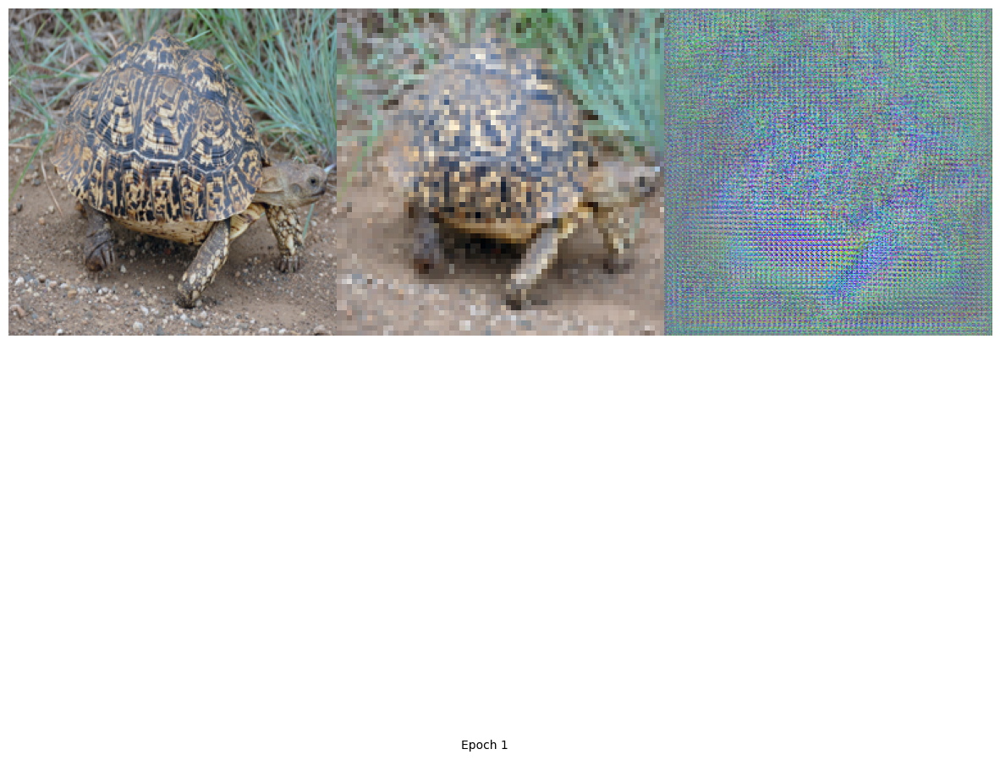

Training Epoch 2 :   0%|          | 0/800 [00:00<?, ?it/s]

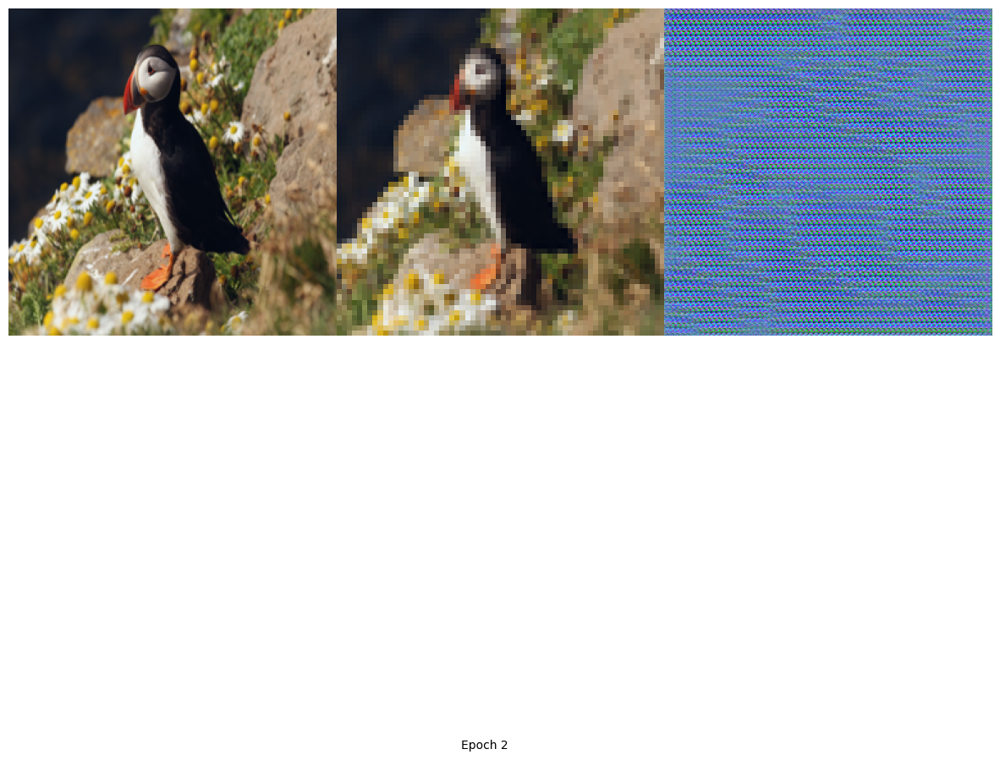

Training Epoch 3 :   0%|          | 0/800 [00:00<?, ?it/s]

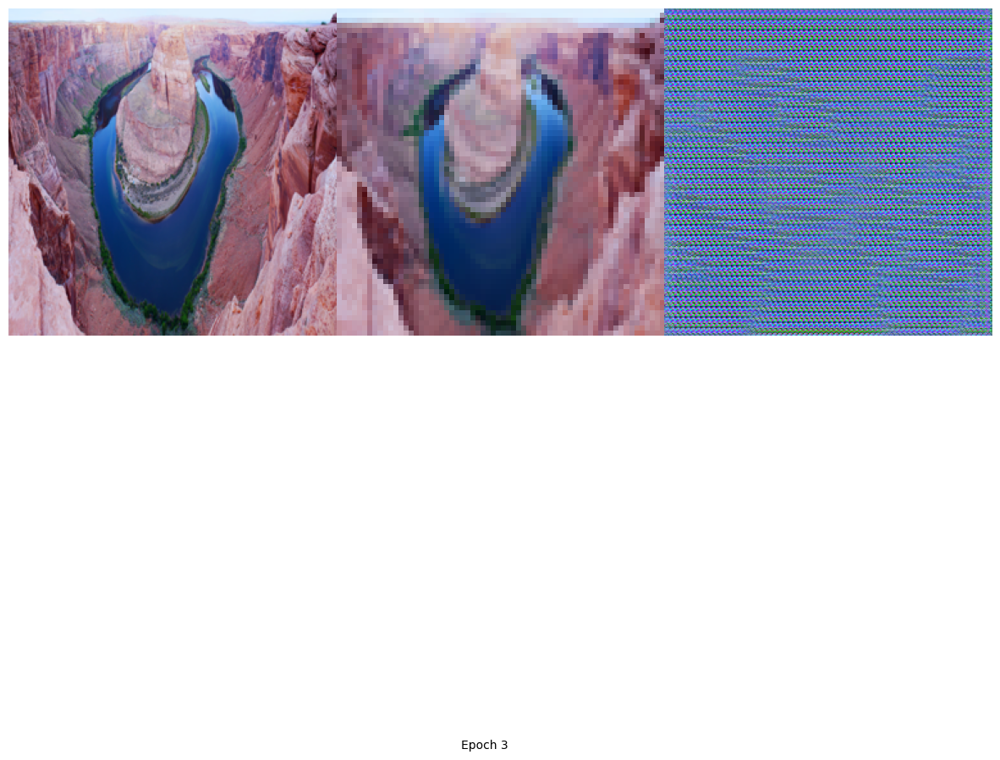

Training Epoch 4 :   0%|          | 0/800 [00:00<?, ?it/s]

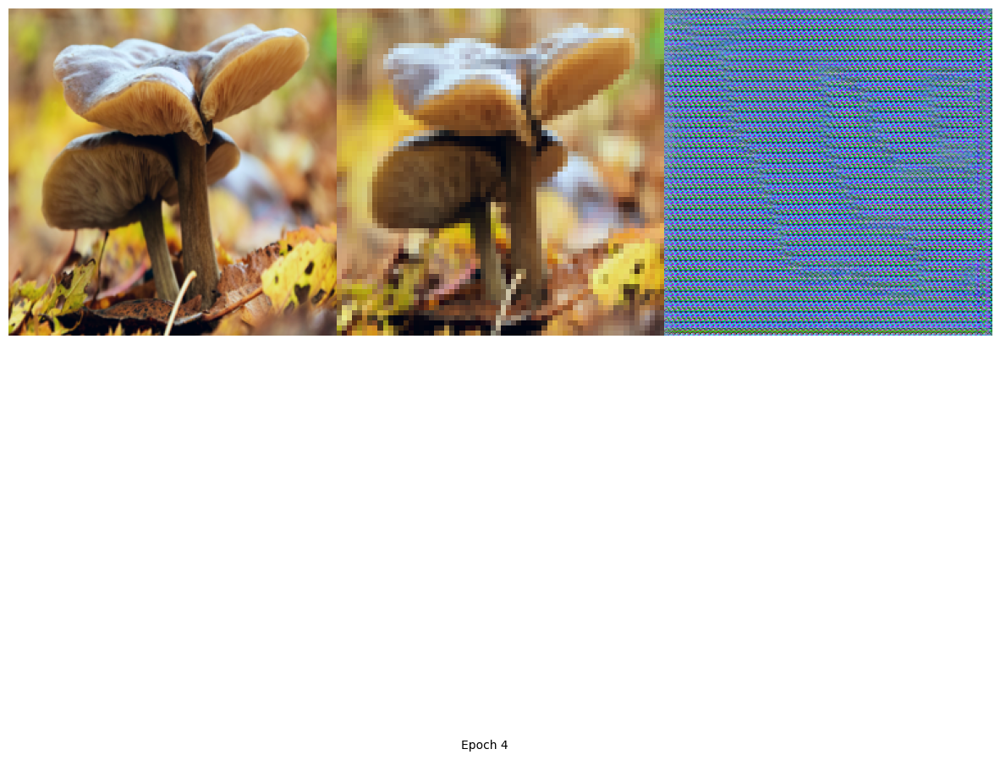

Training Epoch 5 :   0%|          | 0/800 [00:00<?, ?it/s]

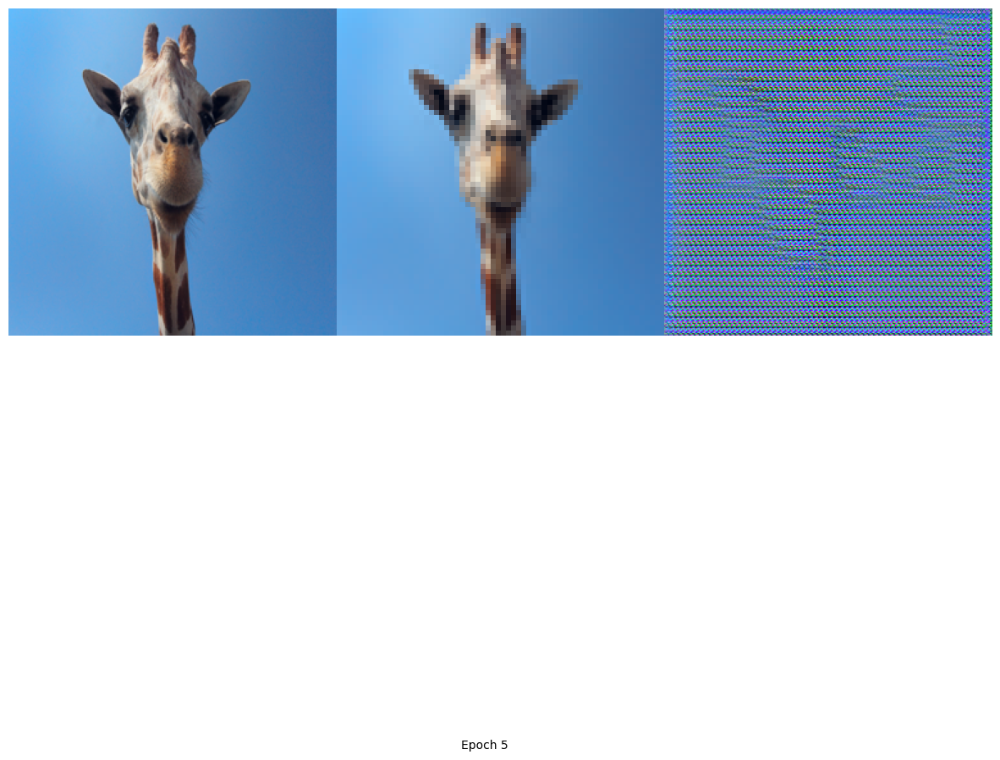

Training Epoch 6 :   0%|          | 0/800 [00:00<?, ?it/s]

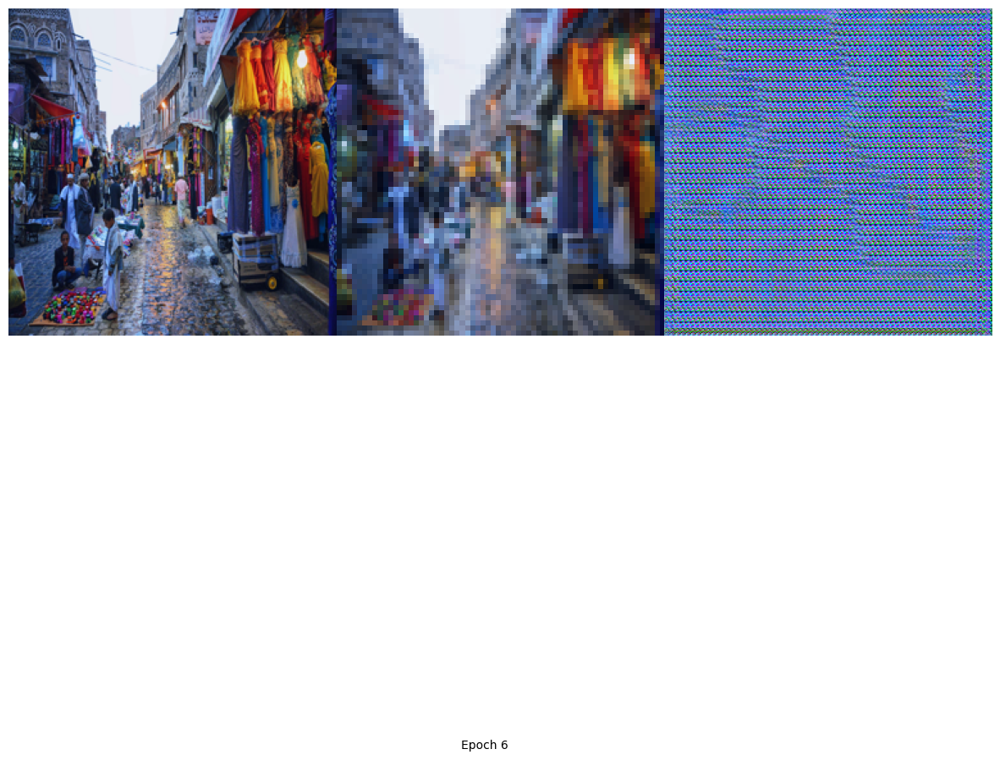

Training Epoch 7 :   0%|          | 0/800 [00:00<?, ?it/s]

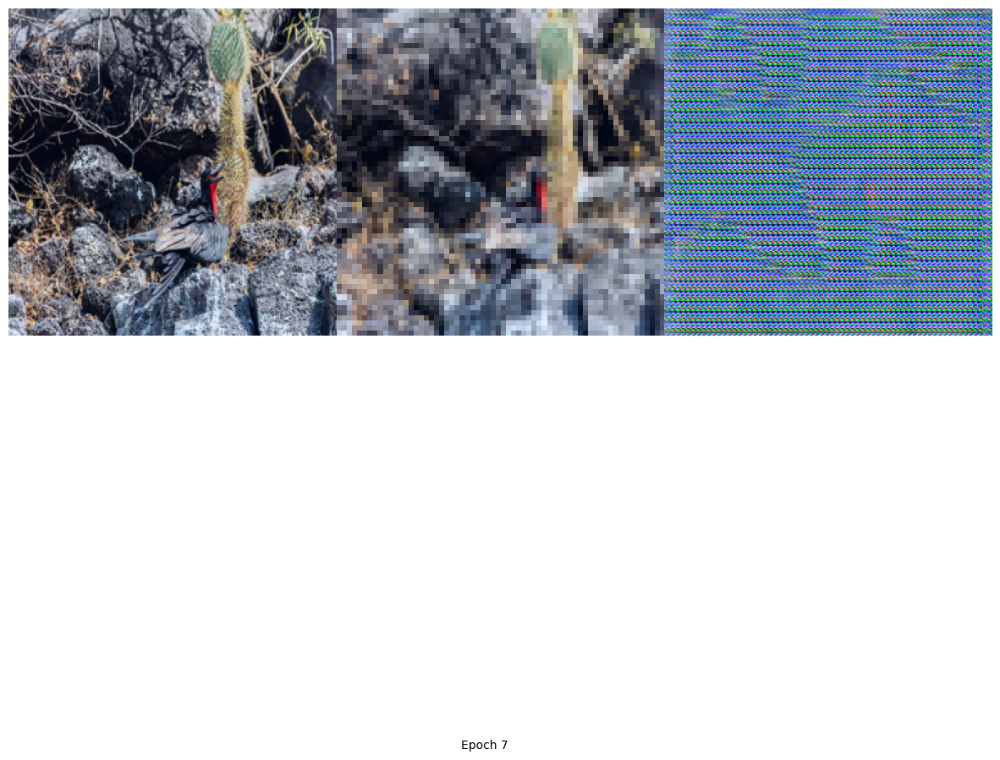

Training Epoch 8 :   0%|          | 0/800 [00:00<?, ?it/s]

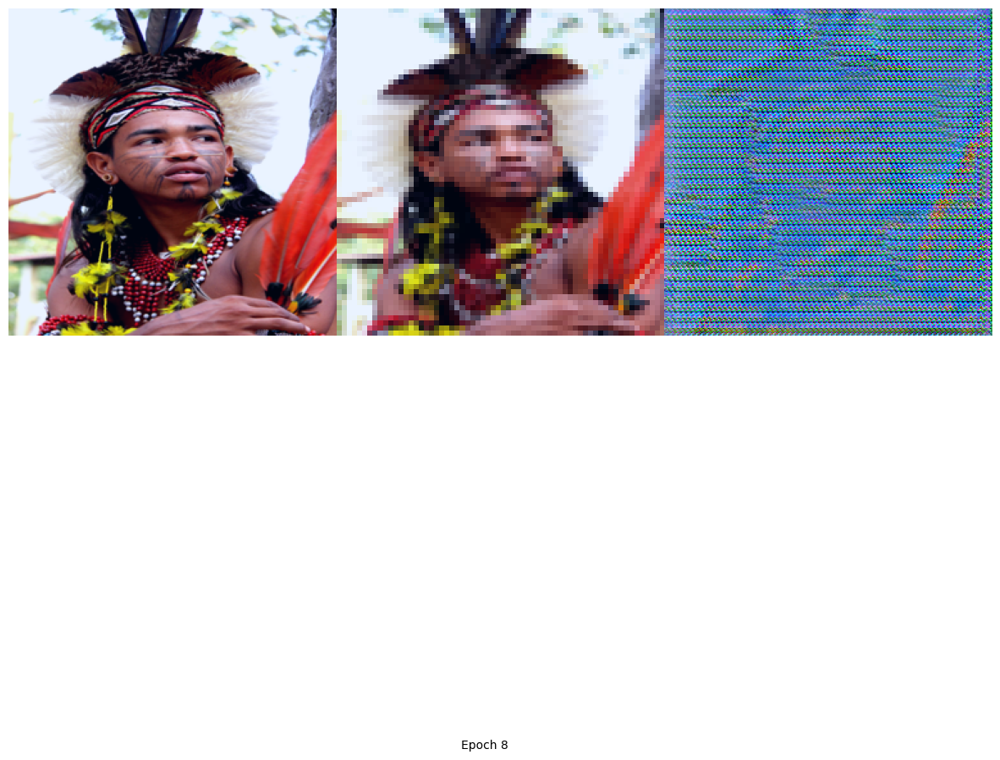

Training Epoch 9 :   0%|          | 0/800 [00:00<?, ?it/s]

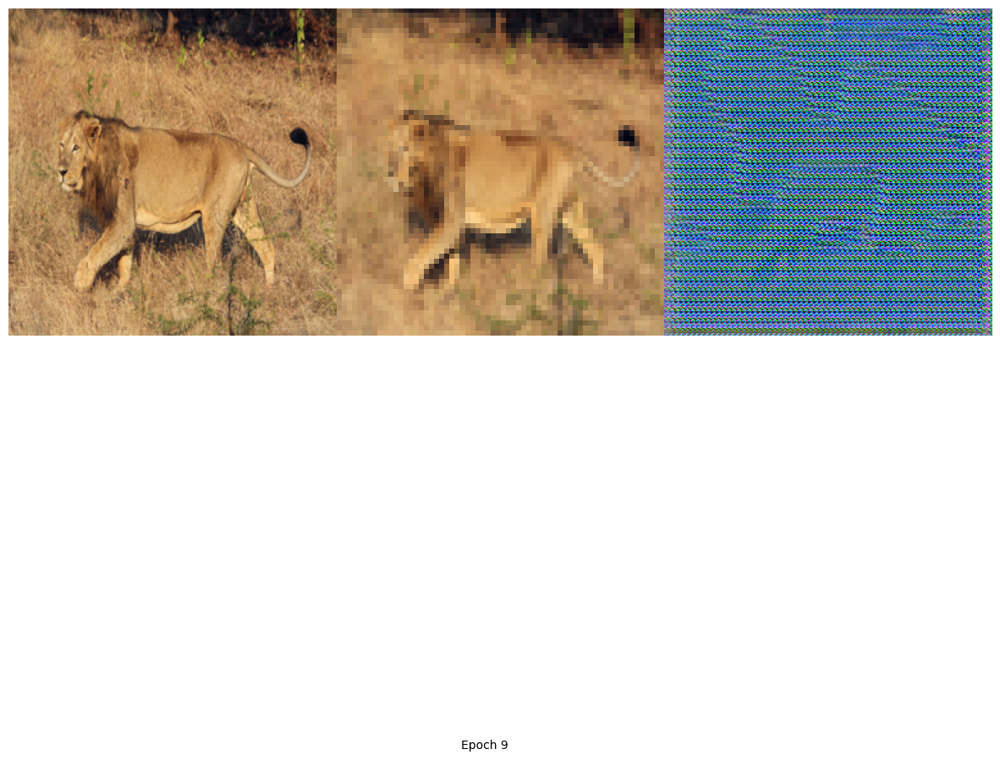

Training Epoch 10 :   0%|          | 0/800 [00:00<?, ?it/s]

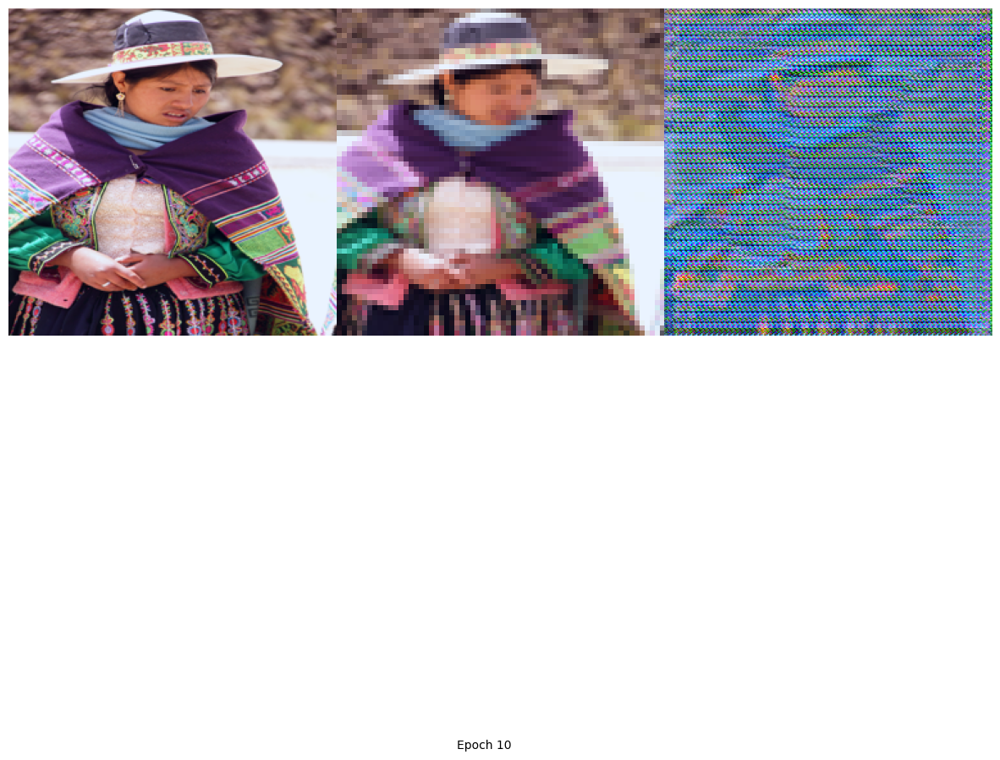

Training Epoch 11 :   0%|          | 0/800 [00:00<?, ?it/s]

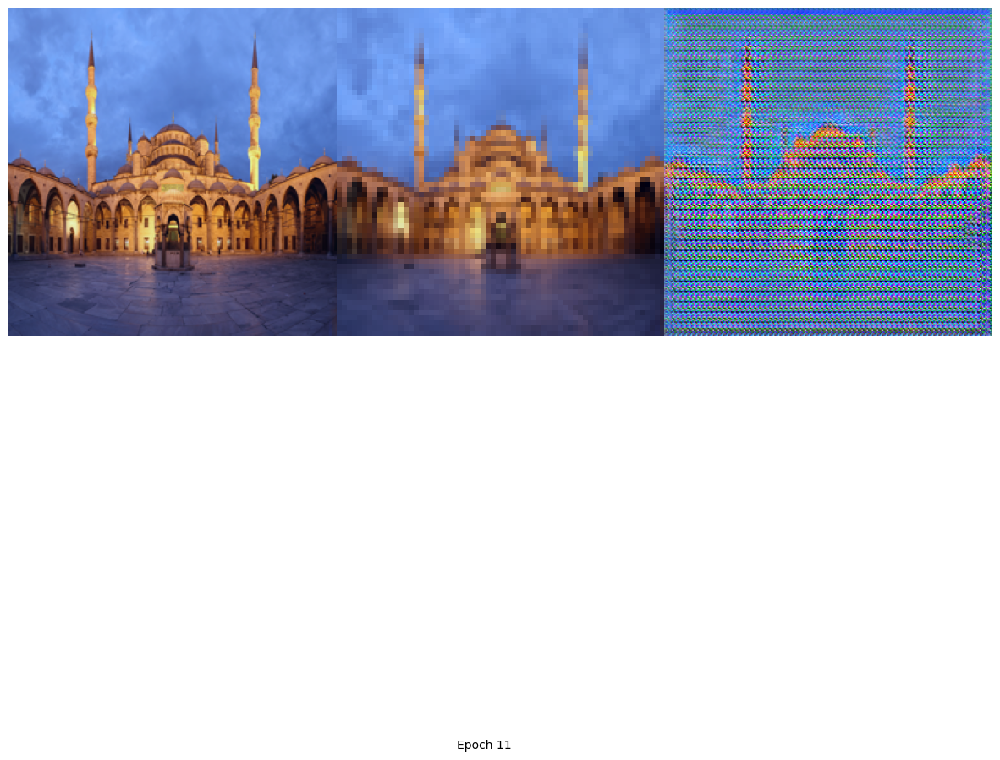

Training Epoch 12 :   0%|          | 0/800 [00:00<?, ?it/s]

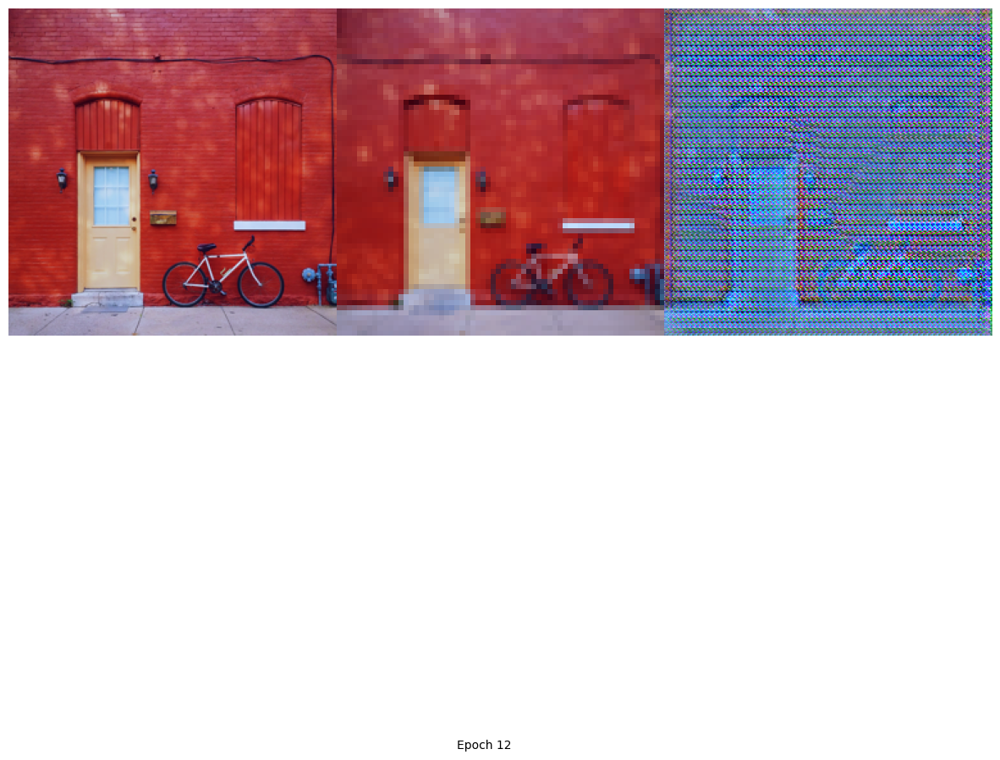

Training Epoch 13 :   0%|          | 0/800 [00:00<?, ?it/s]

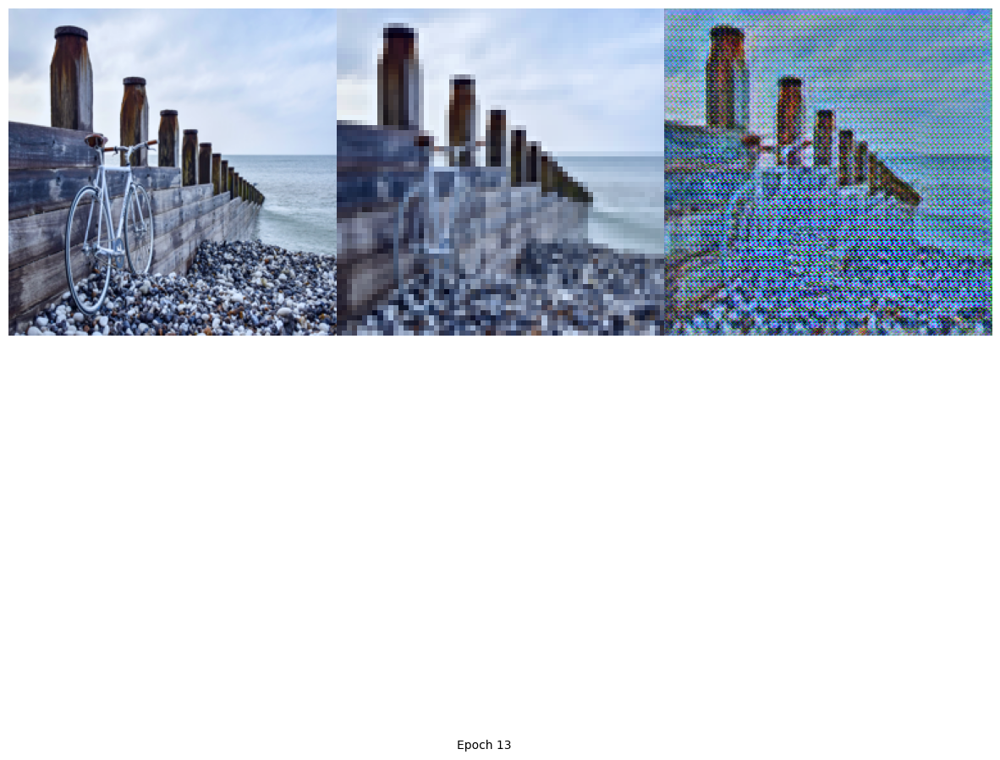

Training Epoch 14 :   0%|          | 0/800 [00:00<?, ?it/s]

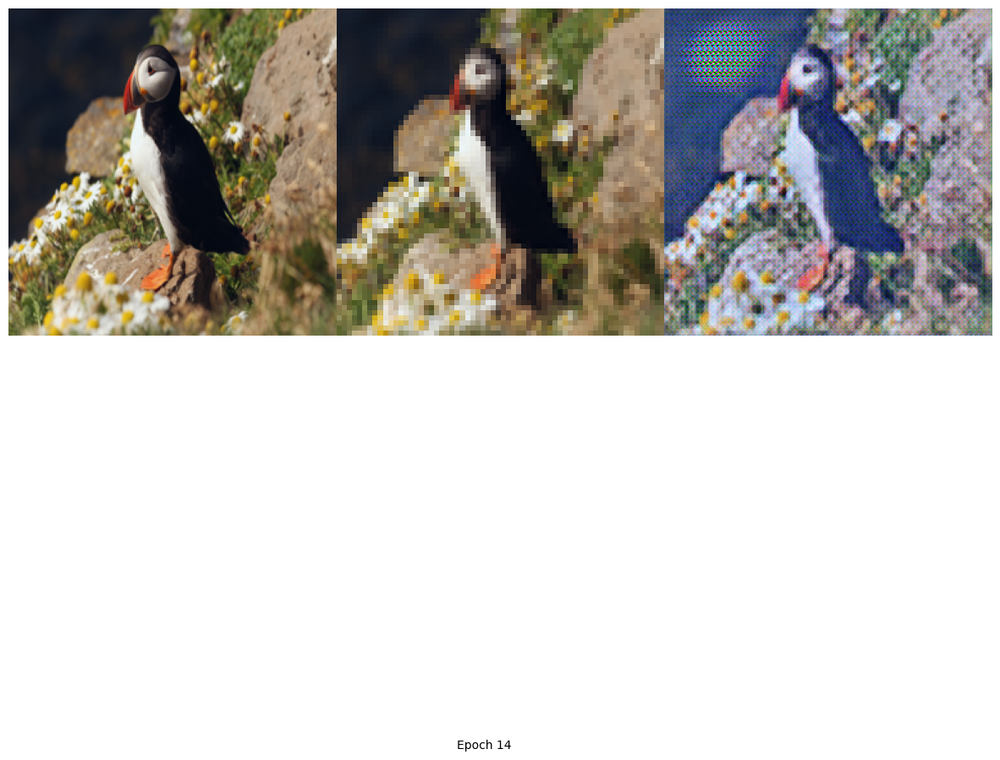

Training Epoch 15 :   0%|          | 0/800 [00:00<?, ?it/s]

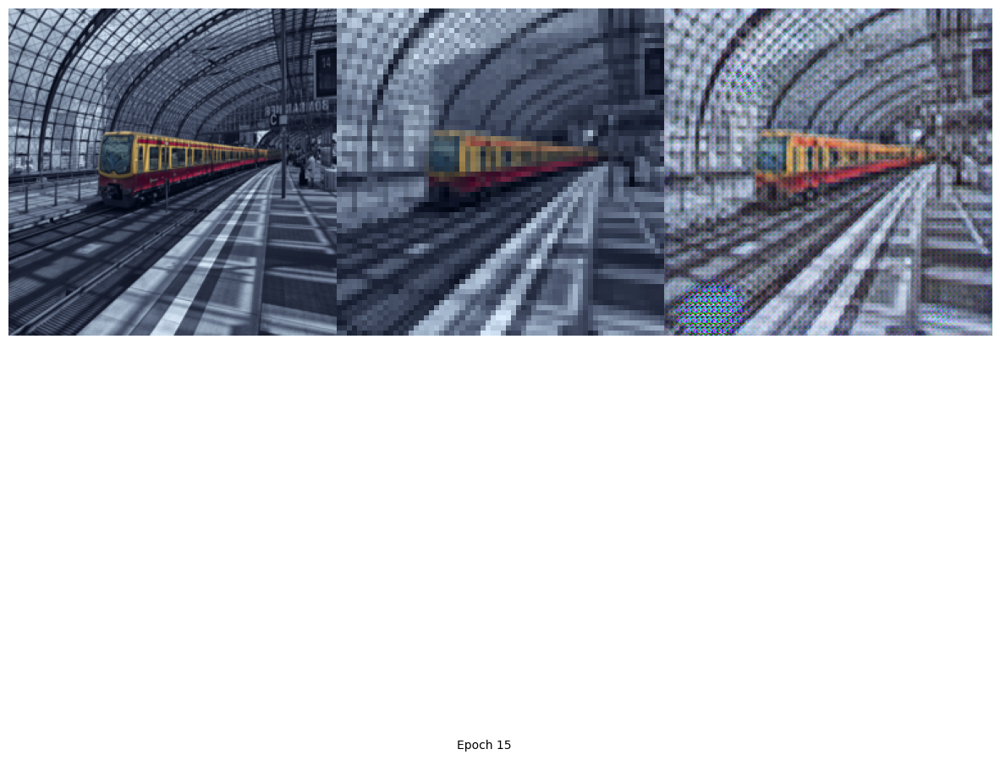

Training Epoch 16 :   0%|          | 0/800 [00:00<?, ?it/s]

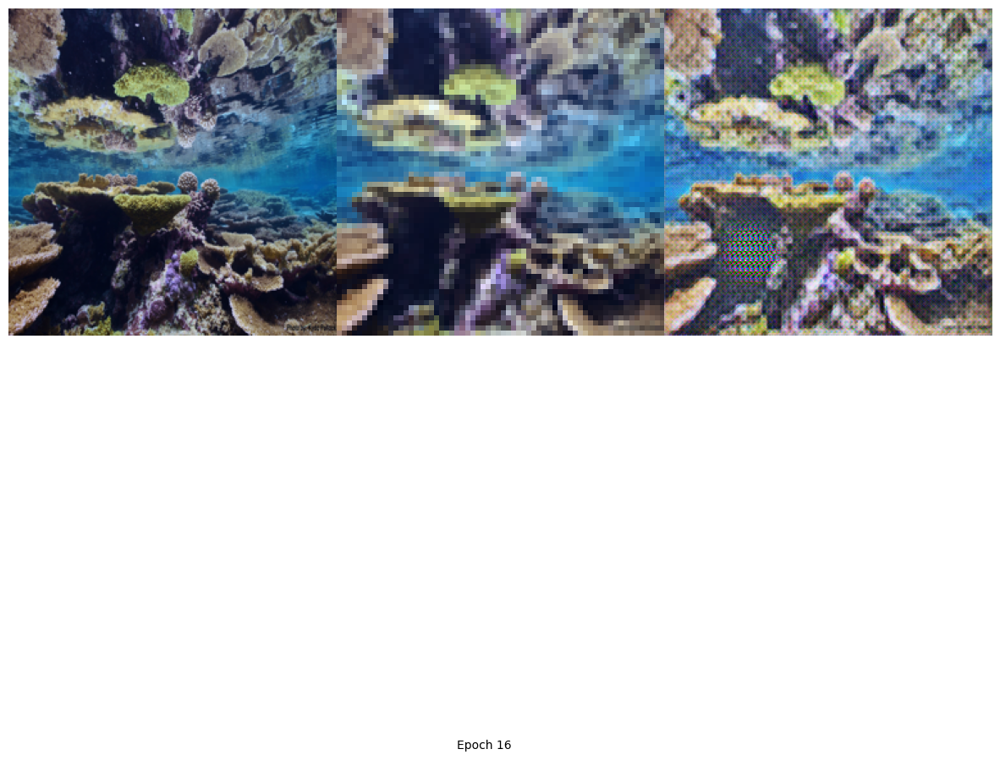

Training Epoch 17 :   0%|          | 0/800 [00:00<?, ?it/s]

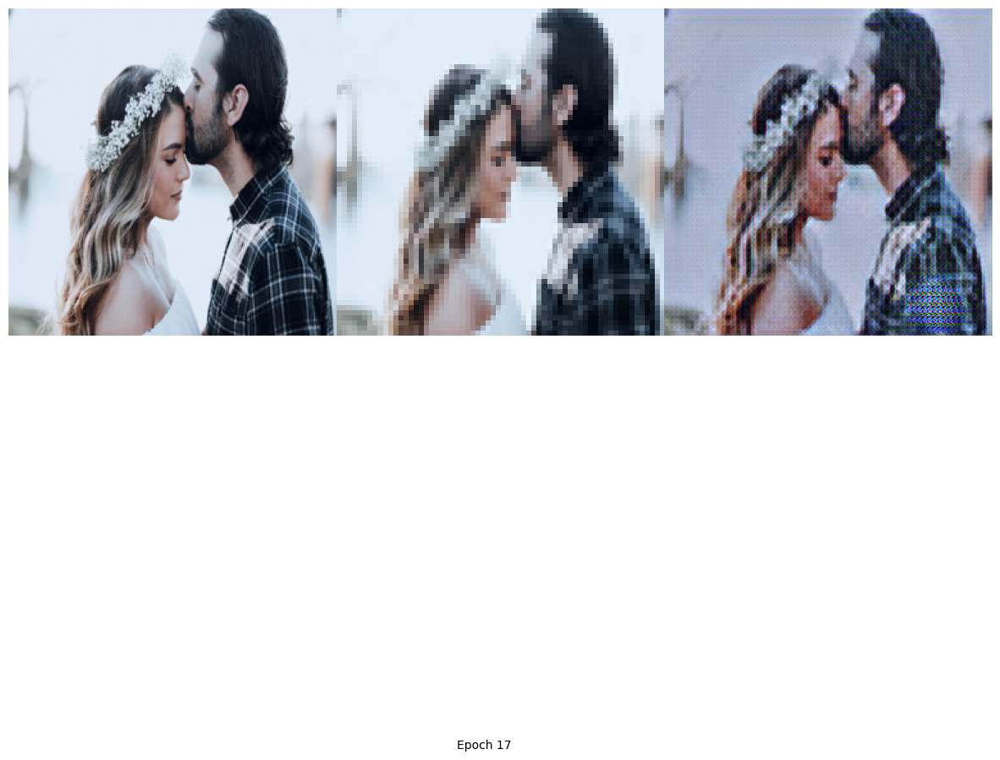

Training Epoch 18 :   0%|          | 0/800 [00:00<?, ?it/s]

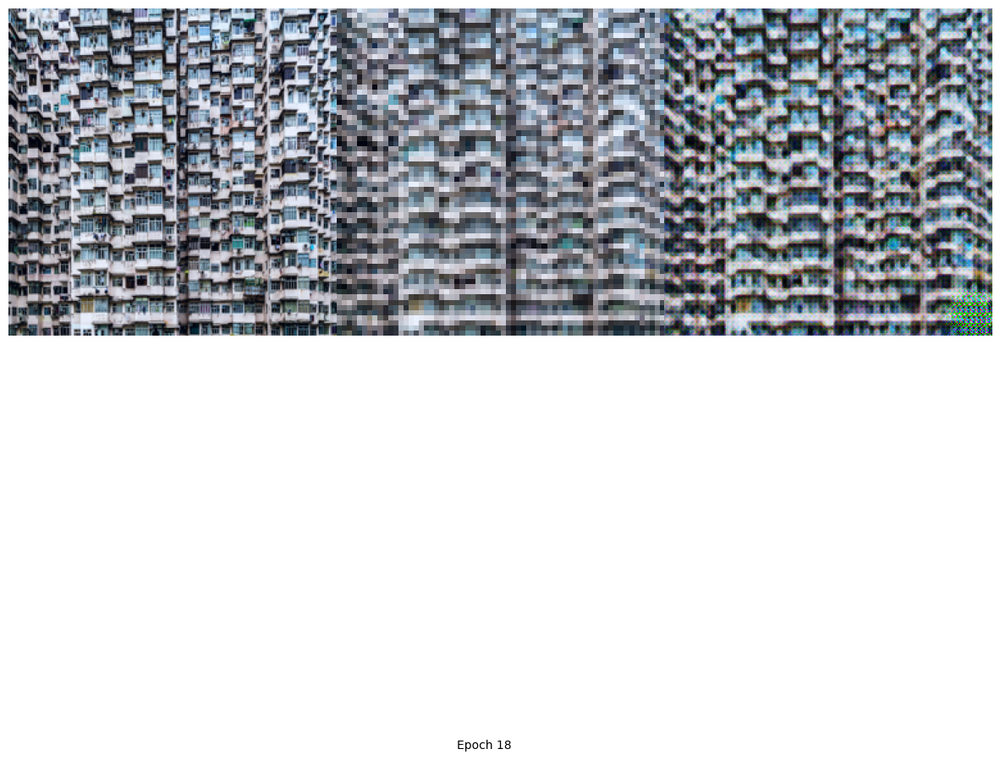

Training Epoch 19 :   0%|          | 0/800 [00:00<?, ?it/s]

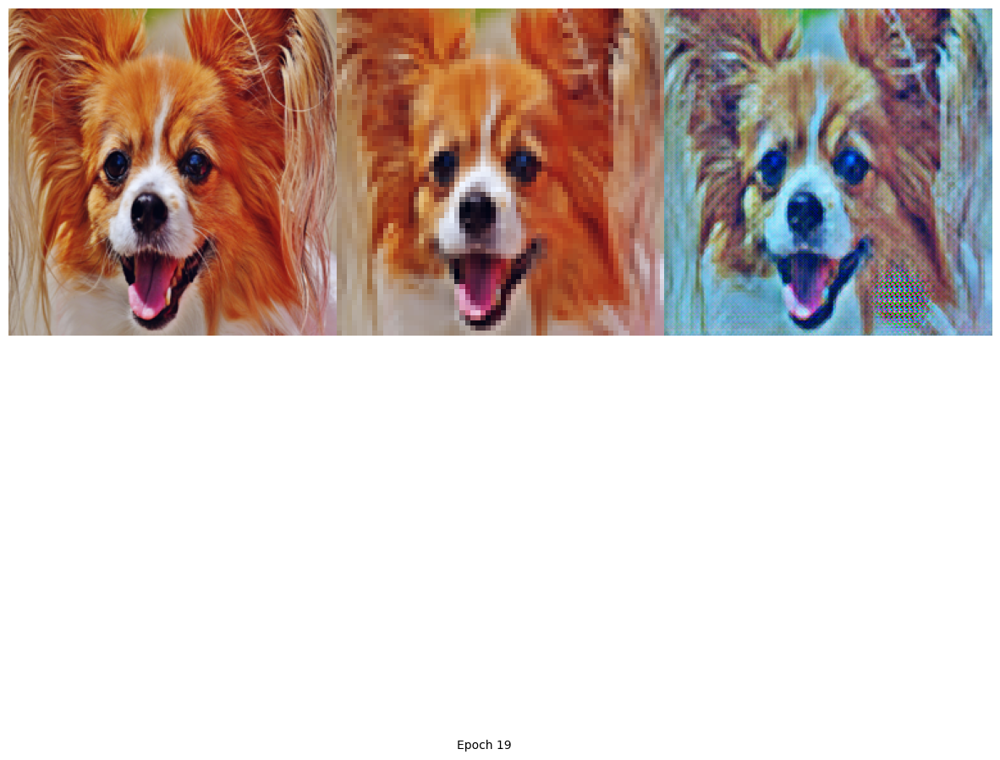

Training Epoch 20 :   0%|          | 0/800 [00:00<?, ?it/s]

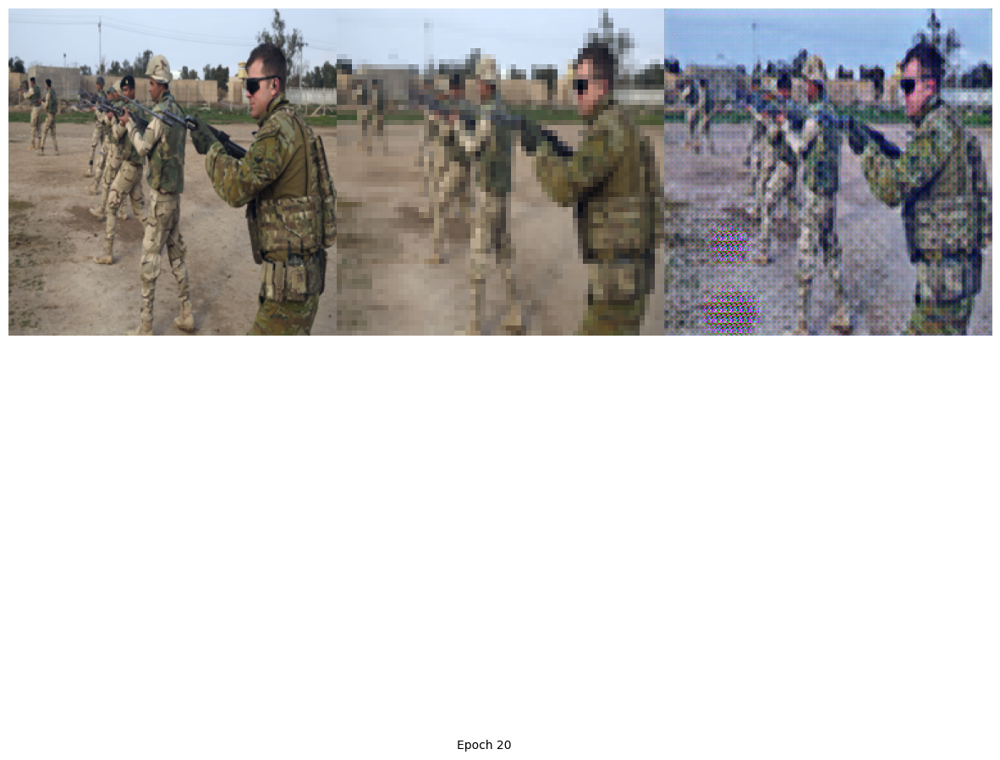

Training Epoch 21 :   0%|          | 0/800 [00:00<?, ?it/s]

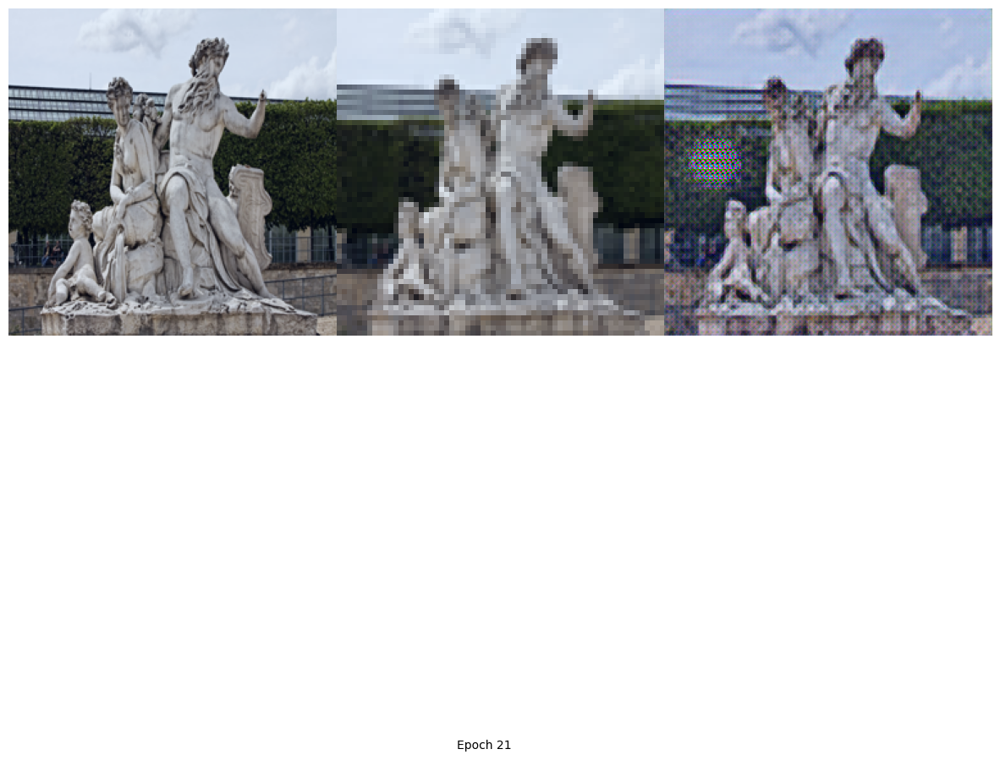

Training Epoch 22 :   0%|          | 0/800 [00:00<?, ?it/s]

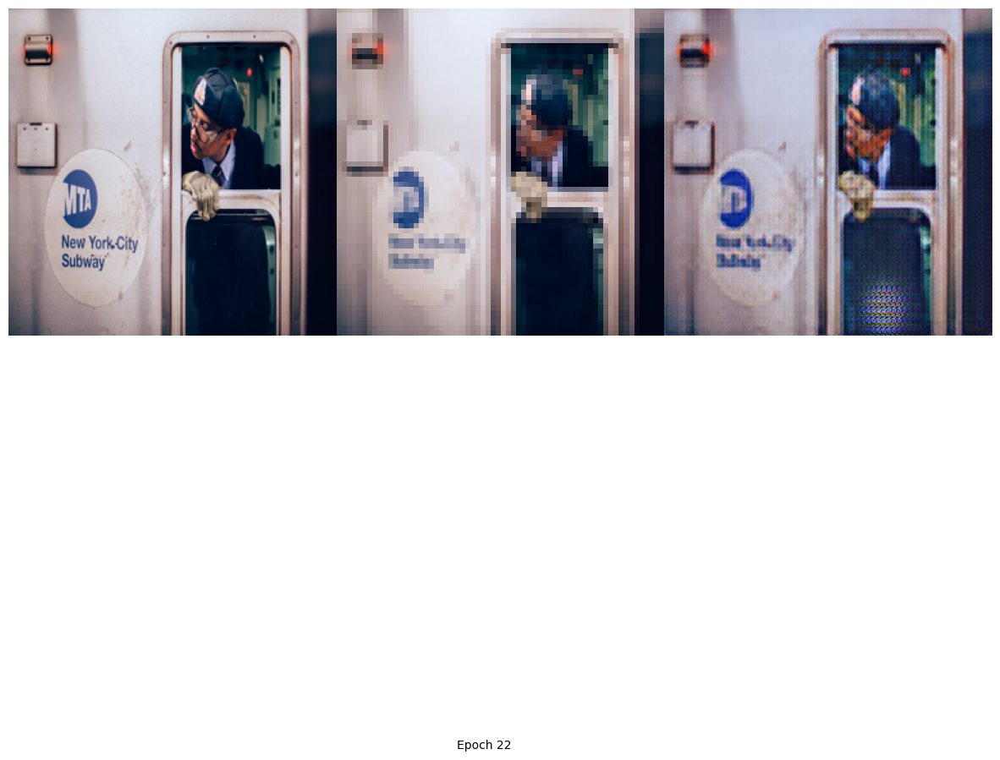

Training Epoch 23 :   0%|          | 0/800 [00:00<?, ?it/s]

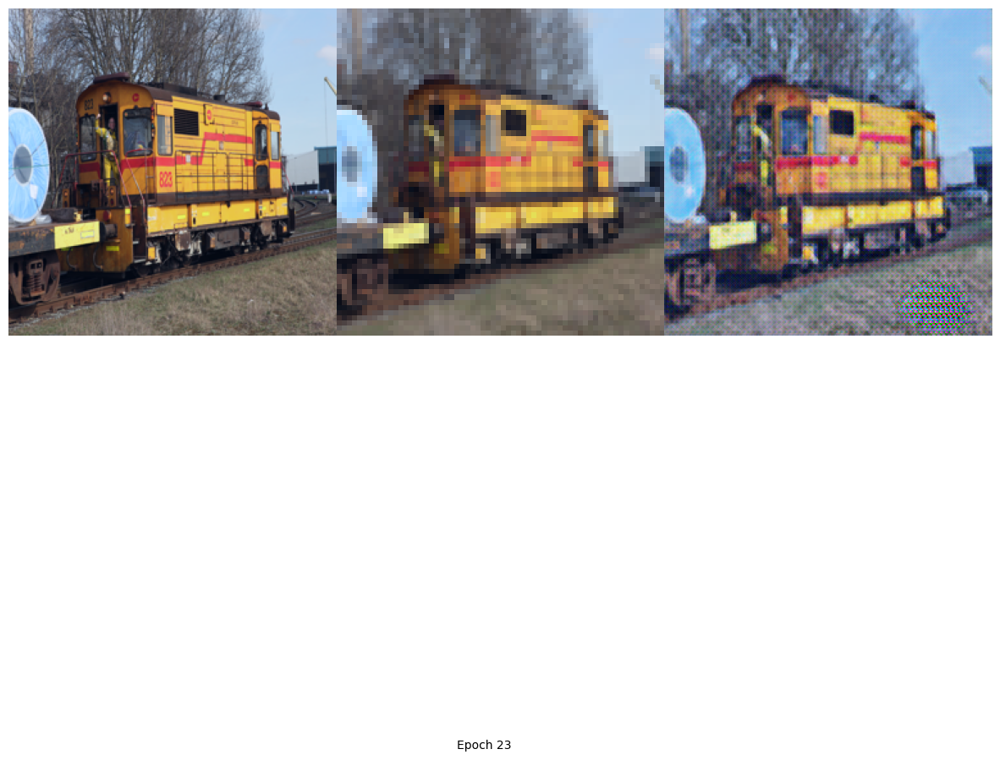

Training Epoch 24 :   0%|          | 0/800 [00:00<?, ?it/s]

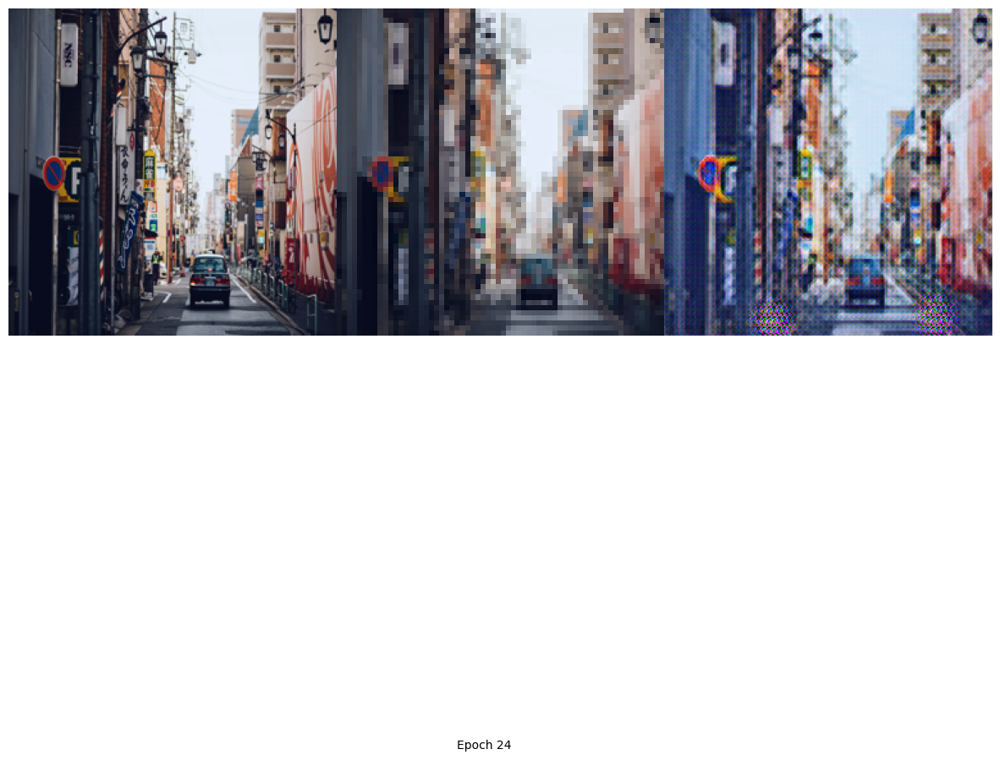

Training Epoch 25 :   0%|          | 0/800 [00:00<?, ?it/s]

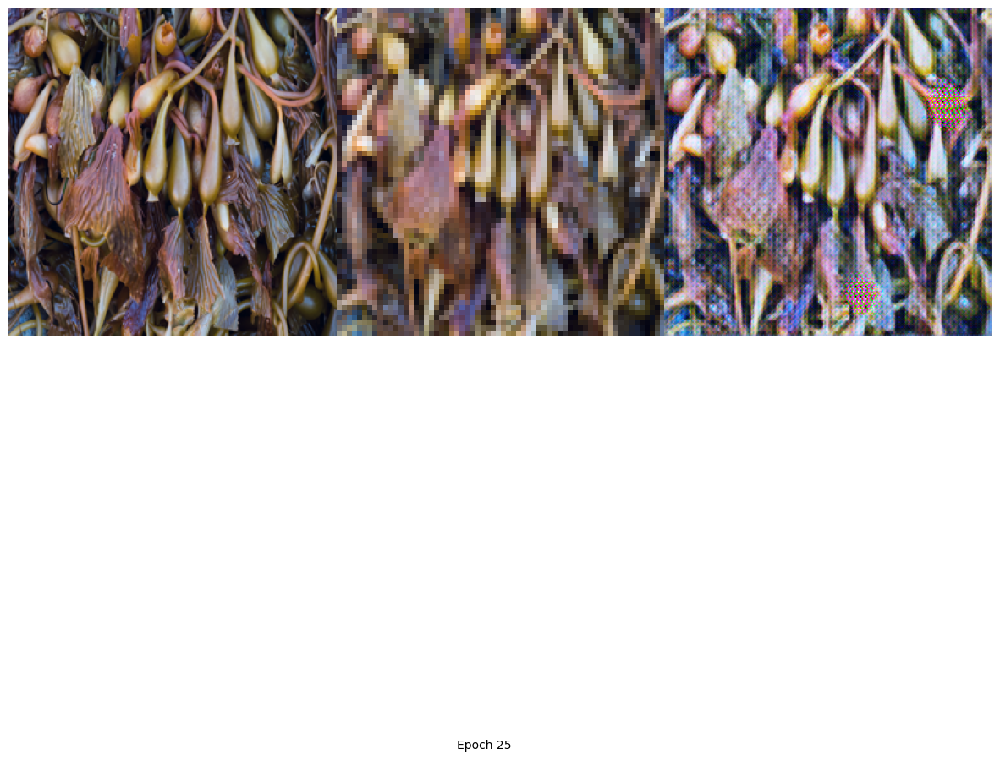

Training Epoch 26 :   0%|          | 0/800 [00:00<?, ?it/s]

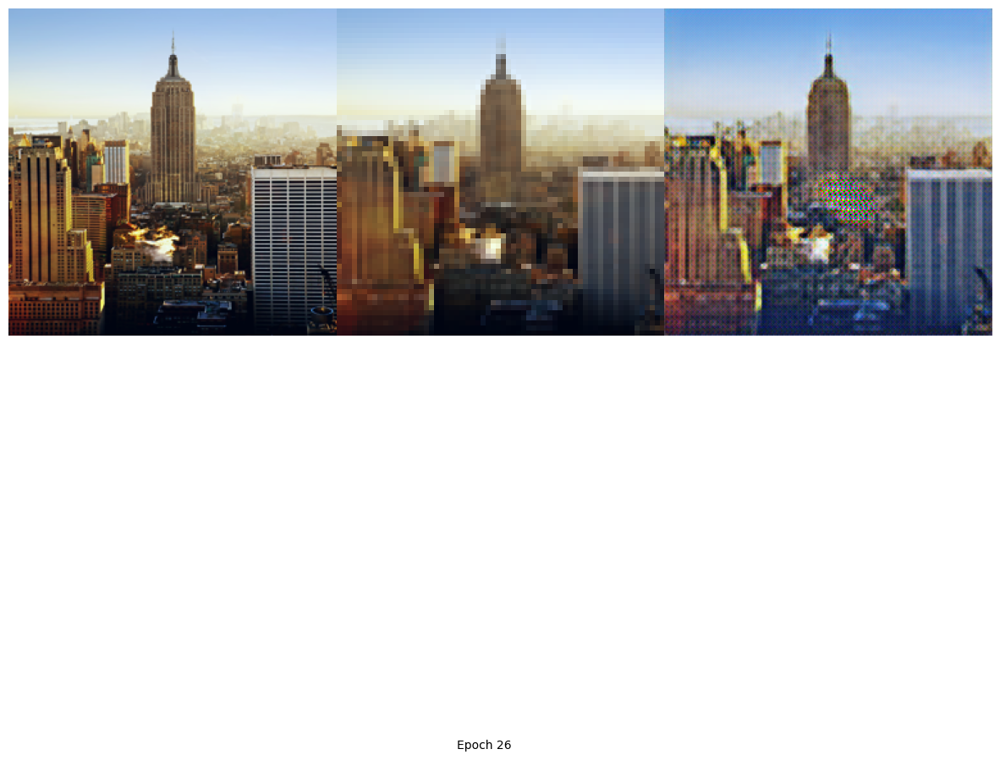

Training Epoch 27 :   0%|          | 0/800 [00:00<?, ?it/s]

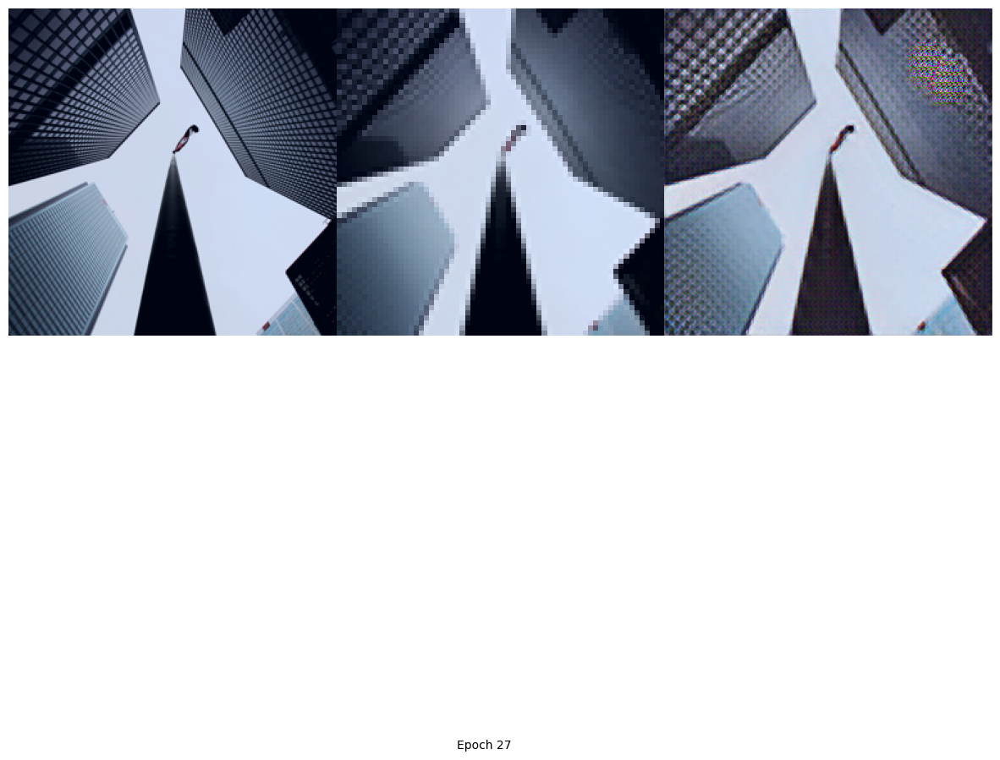

Training Epoch 28 :   0%|          | 0/800 [00:00<?, ?it/s]

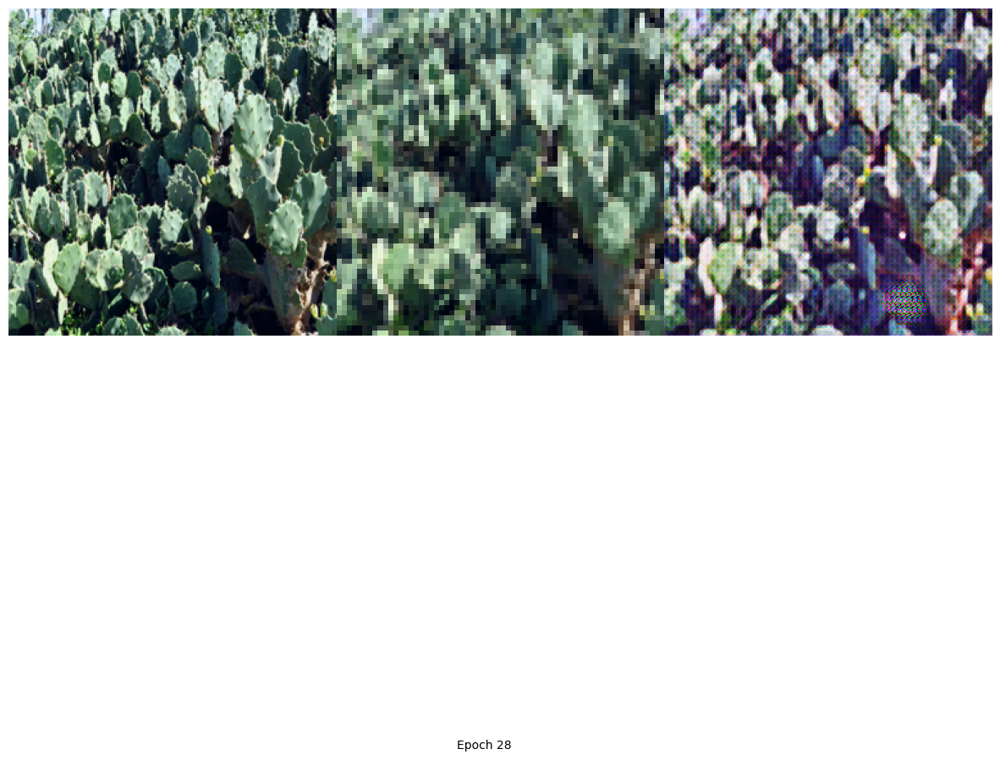

Training Epoch 29 :   0%|          | 0/800 [00:00<?, ?it/s]

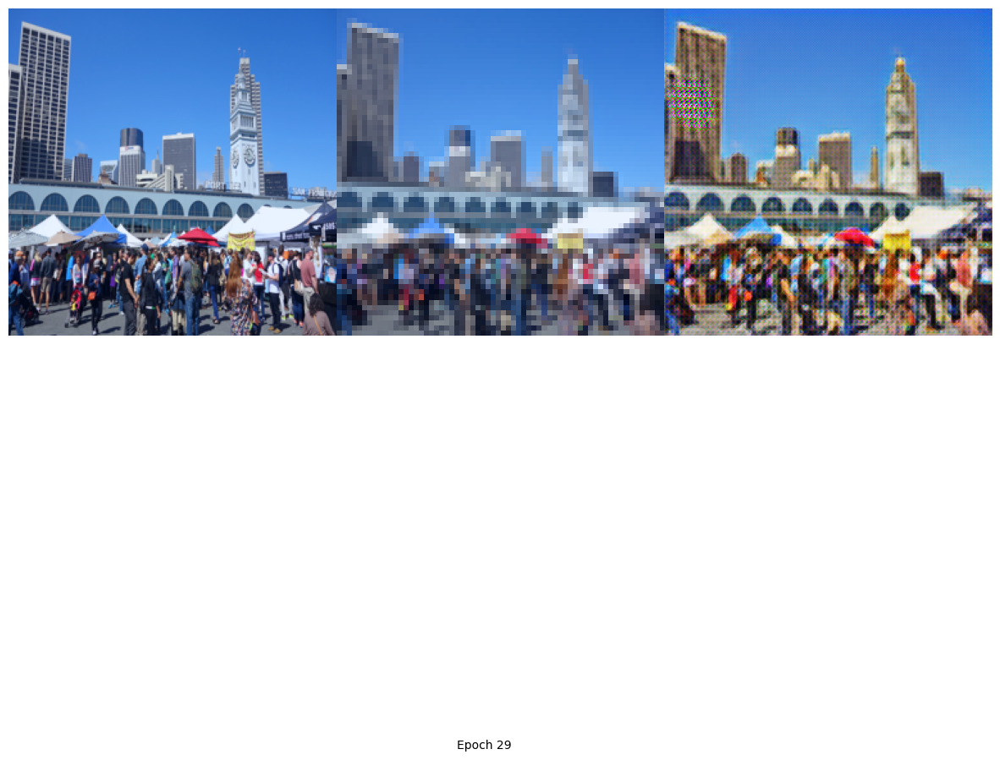

Training Epoch 30 :   0%|          | 0/800 [00:00<?, ?it/s]

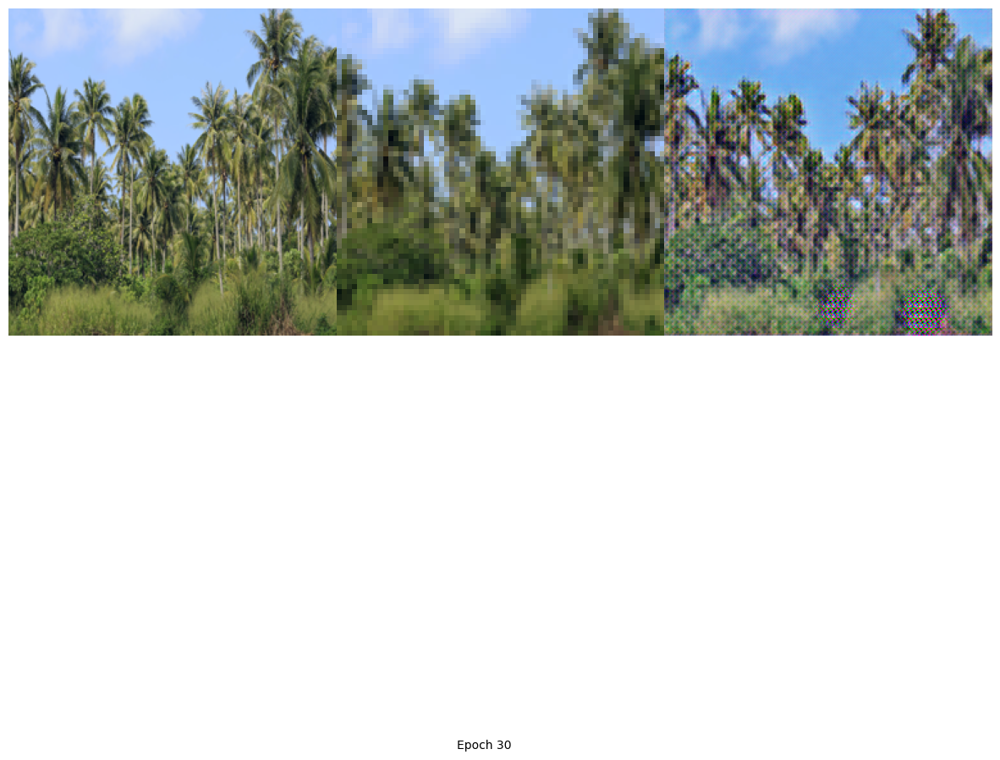

Training Epoch 30 : 100%|██████████| 800/800 [02:40<00:00,  4.98it/s, disc_loss=0.000123, gen_loss=1.13]


In [47]:
if not os.path.exists('val_outputs'):
    os.makedirs('val_outputs')
max_epochs=30
for epoch in range(max_epochs):
    count=0
    gen_loss, disc_loss = 0, 0
    tqdm_bar = tqdm(train_dataloader, desc=f'Training Epoch {epoch+1} ', total=int(len(train_dataloader)))
    for batch_idx, imgs in enumerate(tqdm_bar):
        generator.train(); discriminator.train()
        imgs_lr = Variable(imgs["lr"].type(Tensor))
        imgs_hr = Variable(imgs["hr"].type(Tensor))
        valid = Variable(Tensor(np.ones((imgs_lr.size(0), *discriminator.output_shape))), requires_grad=False)
        fake = Variable(Tensor(np.zeros((imgs_lr.size(0), *discriminator.output_shape))), requires_grad=False)
        optimizer_G.zero_grad()
        gen_hr = generator(imgs_lr)
        loss_GAN = criterion_GAN(discriminator(gen_hr), valid)
        gen_features = feature_extractor(gen_hr)
        real_features = feature_extractor(imgs_hr)
        loss_content = criterion_content(gen_features, real_features)
        loss_G = loss_content + 1e-3 * loss_GAN
        loss_G.backward()
        optimizer_G.step()
        
  
        
        if(count%9000 == 0):
            plot_train_result(imgs_hr, imgs_lr, gen_hr, epoch) 
        count = count+1    
        optimizer_D.zero_grad()
        loss_real = criterion_GAN(discriminator(imgs_hr), valid)
        loss_fake = criterion_GAN(discriminator(gen_hr.detach()), fake)
        loss_D = (loss_real + loss_fake) / 2
        loss_D.backward()
        optimizer_D.step()

        gen_loss += loss_G.item()
        train_gen_losses.append(loss_G.item())
        disc_loss += loss_D.item()
        train_disc_losses.append(loss_D.item())
        train_counter.append(batch_idx*batch_size + imgs_lr.size(0) + epoch*len(train_dataloader.dataset))
        tqdm_bar.set_postfix(gen_loss=gen_loss/(batch_idx+1), disc_loss=disc_loss/(batch_idx+1))
        if (count%500==0):
            imgs_lr = nn.functional.interpolate(imgs_lr, scale_factor=4)
            imgs_hr = make_grid(imgs_hr, nrow=1, normalize=True)
            gen_hr = make_grid(gen_hr, nrow=1, normalize=True)
            imgs_lr = make_grid(imgs_lr, nrow=1, normalize=True)
            img_grid = torch.cat((imgs_hr, imgs_lr, gen_hr), -1)
            save_image(img_grid, f"images/{batch_idx}.png", normalize=False)
        if np.argmin(train_gen_losses) == len(train_gen_losses)-1:
            torch.save(generator.state_dict(), "saved_models/generator.pth")
            torch.save(discriminator.state_dict(), "saved_models/discriminator.pth")

    generator.eval(); discriminator.eval()
    val_gen_loss, val_disc_loss = 0, 0
    with torch.no_grad():
        for batch_idx, imgs in enumerate(test_dataloader):
            imgs_lr = Variable(imgs["lr"].type(Tensor))
            imgs_hr = Variable(imgs["hr"].type(Tensor))
            gen_hr = generator(imgs_lr)
            loss_val_GAN = criterion_GAN(discriminator(gen_hr), valid)
            gen_features = feature_extractor(gen_hr)
            real_features = feature_extractor(imgs_hr)
            loss_val_content = criterion_content(gen_features, real_features)
            loss_val_G = loss_val_content + 1e-3 * loss_val_GAN
            val_gen_losses.append(loss_val_G.item())
            loss_val_real = criterion_GAN(discriminator(imgs_hr), valid)
            loss_val_fake = criterion_GAN(discriminator(gen_hr.detach()), fake)
            loss_val_D = (loss_val_real + loss_val_fake) / 2
            val_disc_losses.append(loss_val_D.item())
            psnr=calc_psnr(imgs_hr, gen_hr)
            psnrs.append(psnr)

            test_counter.append(batch_idx*batch_size + imgs_lr.size(0) + epoch*len(test_dataloader.dataset))
            imgs_hr = make_grid(imgs_hr, nrow=1, normalize=True)
            gen_hr = make_grid(gen_hr, nrow=1, normalize=True)
            img_grid = torch.cat((imgs_hr, gen_hr), -1)
            epoch_folder = f"val_outputs/epoch_{epoch+1}"
            os.makedirs(epoch_folder, exist_ok=True)
            save_image(img_grid, f"{epoch_folder}/epoch_{epoch+1}_batch_{batch_idx+1}.png", normalize=False)

        val_gen_epoch_loss.append(np.mean(val_gen_losses))
        val_disc_epoch_loss.append(np.mean(val_disc_losses))
        train_gen_epoch_loss.append(np.mean(train_gen_losses))
        train_disc_epoch_loss.append(np.mean(train_disc_losses))
        psnr_epoch.append(np.mean(torch.Tensor.cpu(torch.Tensor(psnrs)).numpy()))

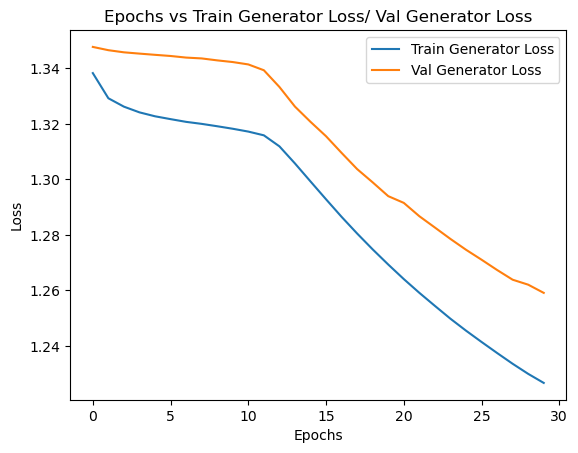

In [48]:
#Plot Generator Losses
plt.plot(train_gen_epoch_loss, label='Train Generator Loss')
plt.plot(val_gen_epoch_loss, label='Val Generator Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.title('Epochs vs Train Generator Loss/ Val Generator Loss')
plt.show()

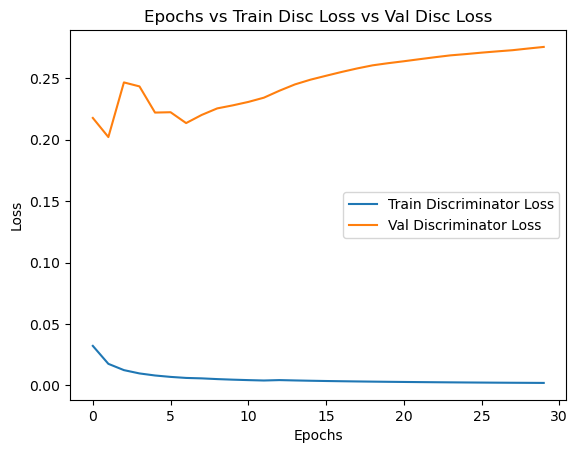

In [49]:
#Plot Discriminator Loss
plt.plot(train_disc_epoch_loss, label='Train Discriminator Loss')
plt.plot(val_disc_epoch_loss, label='Val Discriminator Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.title('Epochs vs Train Disc Loss vs Val Disc Loss')
plt.show()

In [50]:
import cv2
import numpy as np

def calculate_psnr(img1_path, img2_path):
    img1 = cv2.imread(img1_path)
    img2 = cv2.imread(img2_path)
    img2 = cv2.resize(img2, (256, 256))
    mse = np.mean((img1 - img2) ** 2)
    if mse == 0:
        psnr = 100
    else:
        max_pixel = 255.0
        psnr = 10 * np.log10((max_pixel ** 2) / mse)

    return psnr

psnr_values = []
for i, batch in enumerate(test_dataloader):
    imgs_lr = batch["lr"].cuda()
    imgs_hr = batch["hr"].cuda()

    gen_hr = generator(imgs_lr)
    save_image(gen_hr, f"images/{i}.png")
    for j in range(imgs_hr.shape[0]):
        psnr = calculate_psnr(f"images/{i}.png", test_paths[i * batch_size + j])
        psnr_values.append(psnr)

average_psnr = sum(psnr_values) / len(psnr_values)
print("Average PSNR:", average_psnr)

Average PSNR: 28.06475973427192
